In [36]:
import os
import matplotlib
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np
from scipy.stats import linregress
from IPython.display import Image as IPImage, display

import time
from tqdm import tqdm

matplotlib.use('Agg')  # faster backend, but no GUI. Save to file instead.

# Designed for running locally, rather than in Google Colab. Ensure directories are configured properly.

In [37]:
base_dir = ".\LOL-v2"
real_train_low_dir = os.path.join(base_dir, "Real_captured/Train/Low")
real_train_normal_dir = os.path.join(base_dir, "Real_captured/Train/Normal")
real_test_low_dir = os.path.join(base_dir, "Real_captured/Test/Low")
real_test_normal_dir = os.path.join(base_dir, "Real_captured/Test/Normal")


synthetic_train_low_dir = os.path.join(base_dir, "Synthetic/Train/Low")
synthetic_train_normal_dir = os.path.join(base_dir, "Synthetic/Train/Normal")
synthetic_test_low_dir = os.path.join(base_dir, "Synthetic/Test/Low")
synthetic_test_normal_dir = os.path.join(base_dir, "Synthetic/Test/Normal")


# Unused. Instead of examining just the images with the lowest 20% SSIM scores, we examine all images and compare.
#real_low_ssim_dir = os.path.join(base_dir, "Low_20_percent/Real")
#synthetic_low_ssim_dir = os.path.join(base_dir, "Low_20_percent/Synthetic")

output_dir = ".\EDAFigs"

In [38]:
def get_image_files(directory):
    valid_extensions = (".png", ".jpg", ".jpeg", ".bmp", ".tiff") 
    return [f for f in os.listdir(directory) if f.lower().endswith(valid_extensions)]

In [39]:
print("Real Captured Dataset:")
print(f"Number of low-light training images: {len(get_image_files(real_train_low_dir))}")
print(f"Number of bright training images:    {len(get_image_files(real_train_normal_dir))}")
print(f"Number of low-light testing images:  {len(get_image_files(real_test_low_dir))}")
print(f"Number of bright testing images:     {len(get_image_files(real_test_normal_dir))}")

print("\nSynthetic Dataset:")
print(f"Number of low-light training images: {len(get_image_files(synthetic_train_low_dir))}")
print(f"Number of bright training images:    {len(get_image_files(synthetic_train_normal_dir))}")
print(f"Number of low-light testing images:  {len(get_image_files(synthetic_test_low_dir))}")
print(f"Number of bright testing images:     {len(get_image_files(synthetic_test_normal_dir))}")

#print("\nLow-light 20% Dataset:")
#print(f"From Real:      {len(get_image_files(real_low_ssim_dir))}")
#print(f"From Synthetic: {len(get_image_files(synthetic_low_ssim_dir))}")

Real Captured Dataset:
Number of low-light training images: 689
Number of bright training images:    689
Number of low-light testing images:  100
Number of bright testing images:     100

Synthetic Dataset:
Number of low-light training images: 900
Number of bright training images:    900
Number of low-light testing images:  100
Number of bright testing images:     100


In [5]:
# Check image dimensions
def get_image_dimensions(directory):
    dimensions = []
    for file in get_image_files(directory):
        with Image.open(os.path.join(directory, file)) as img:
            dimensions.append(img.size)
    return dimensions

print("Unique dimensions in Real Captured Dataset:")
real_dimensions = get_image_dimensions(real_train_low_dir)
print(set(real_dimensions))
print("Unique dimensions in Synthetic Dataset:")
synthetic_dimensions = get_image_dimensions(synthetic_train_low_dir)
print(set(synthetic_dimensions))

Unique dimensions in Real Captured Dataset:
{(600, 400)}
Unique dimensions in Synthetic Dataset:
{(384, 384)}


# Image Collage

In [ ]:
def create_full_image_collage_no_black_bars(directory, output_path, thumbnail_size=(64, 64)):
    image_files = get_image_files(directory)  # Get all image files in the directory
    num_images = len(image_files)
    
    # Dynamically calculate the grid size
    grid_cols = int(np.ceil(np.sqrt(num_images)))  # Number of columns
    grid_rows = int(np.ceil(num_images / grid_cols))  # Number of rows

    # Create a blank canvas for the collage
    collage_width = grid_cols * thumbnail_size[0]
    collage_height = grid_rows * thumbnail_size[1]
    collage = Image.new("RGB", (collage_width, collage_height))

    # Add images to the collage
    for i, file in enumerate(image_files):
        with Image.open(os.path.join(directory, file)) as img:
            # Crop the image to a square aspect ratio
            width, height = img.size
            min_dim = min(width, height)
            left = (width - min_dim) // 2
            top = (height - min_dim) // 2
            right = left + min_dim
            bottom = top + min_dim
            img = img.crop((left, top, right, bottom))

            # Resize to thumbnail size
            img.thumbnail(thumbnail_size)

            # Calculate position in the collage
            x = (i % grid_cols) * thumbnail_size[0]
            y = (i // grid_cols) * thumbnail_size[1]
            collage.paste(img, (x, y))

    # Save the collage
    collage.save(output_path)
    print(f"Collage saved to {output_path}")

# Create collages for low-light images
real_low_collage_output = os.path.join(output_dir, "Collage_Real_Low.png")
synthetic_low_collage_output = os.path.join(output_dir, "Collage_Synthetic_Low.png")


create_full_image_collage_no_black_bars(real_train_low_dir, real_low_collage_output)
create_full_image_collage_no_black_bars(synthetic_train_low_dir, synthetic_low_collage_output)
create_full_image_collage_no_black_bars(real_train_normal_dir, os.path.join(output_dir, "Collage_Real_Normal.png"))
create_full_image_collage_no_black_bars(synthetic_train_normal_dir, os.path.join(output_dir, "Collage_Synthetic_Normal.png"))

Collage saved to .\EDAFigs\Collage_Real_Low.png
Collage saved to .\EDAFigs\Collage_Synthetic_Low.png
Collage saved to .\EDAFigs\Collage_Real_Normal.png
Collage saved to .\EDAFigs\Collage_Synthetic_Normal.png


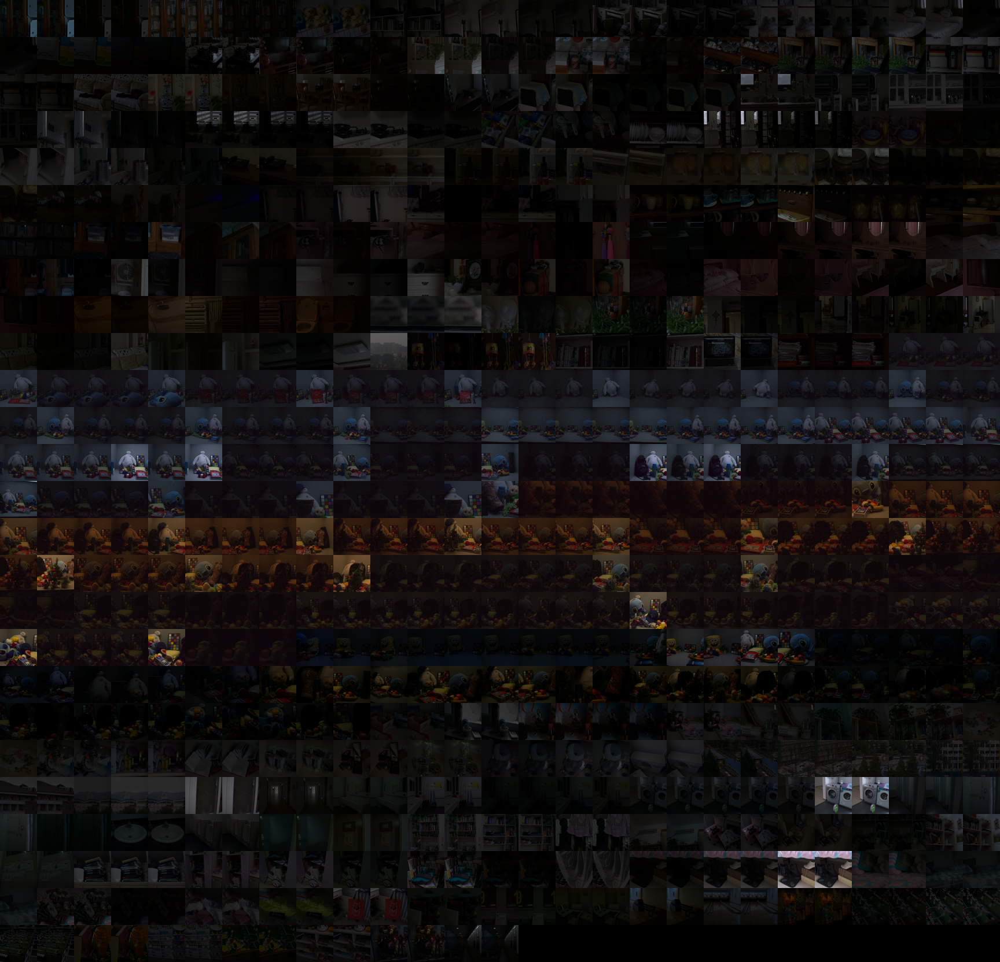

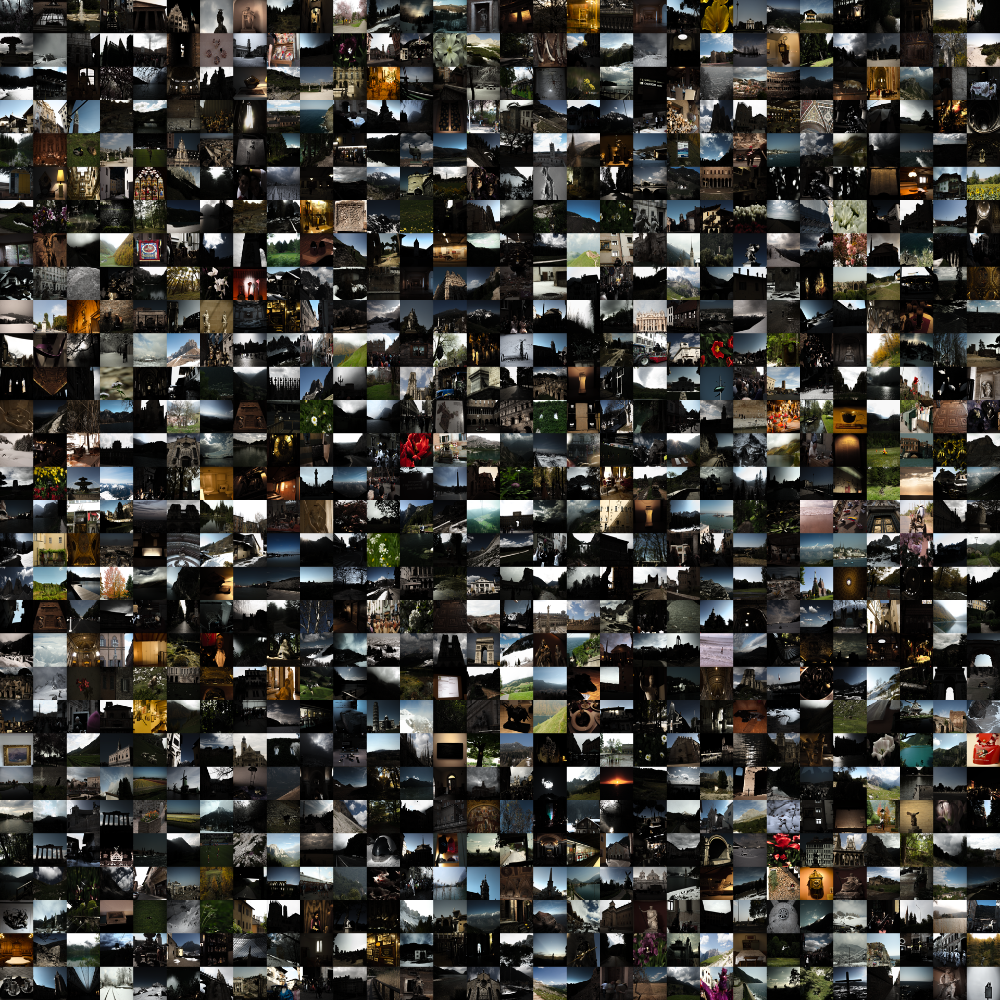

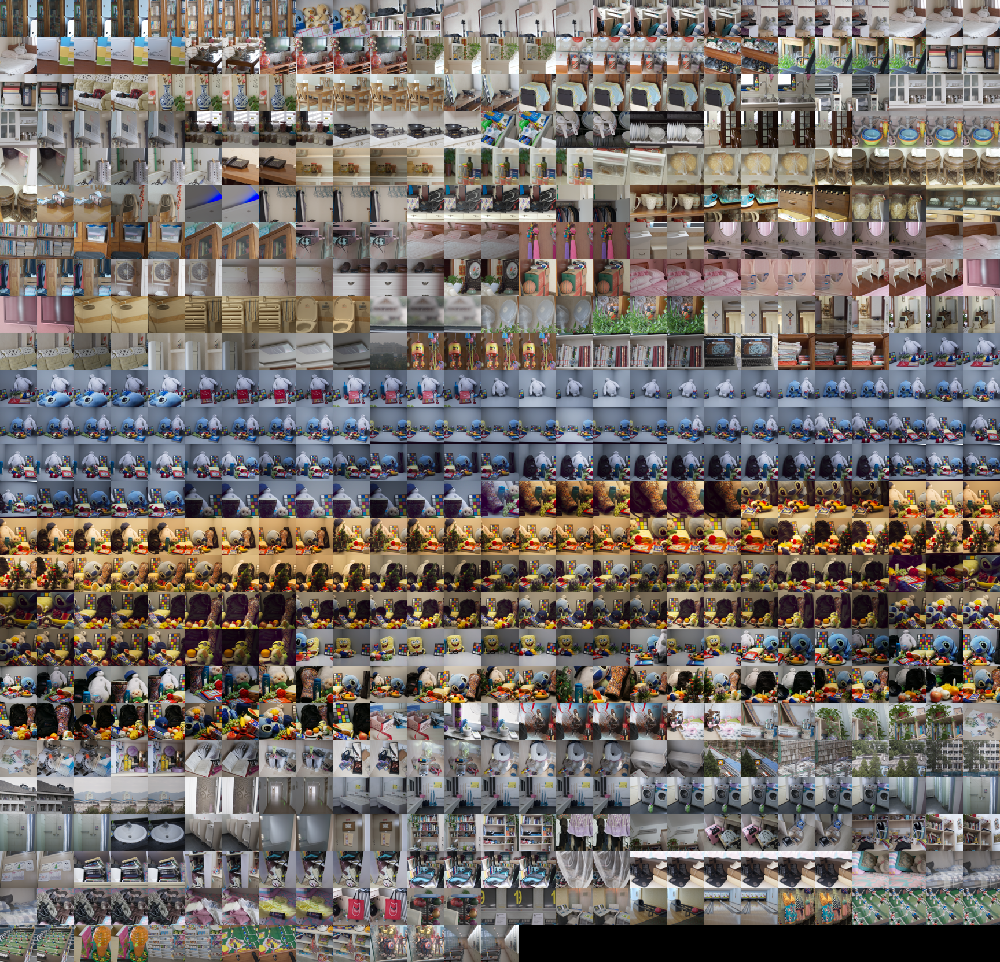

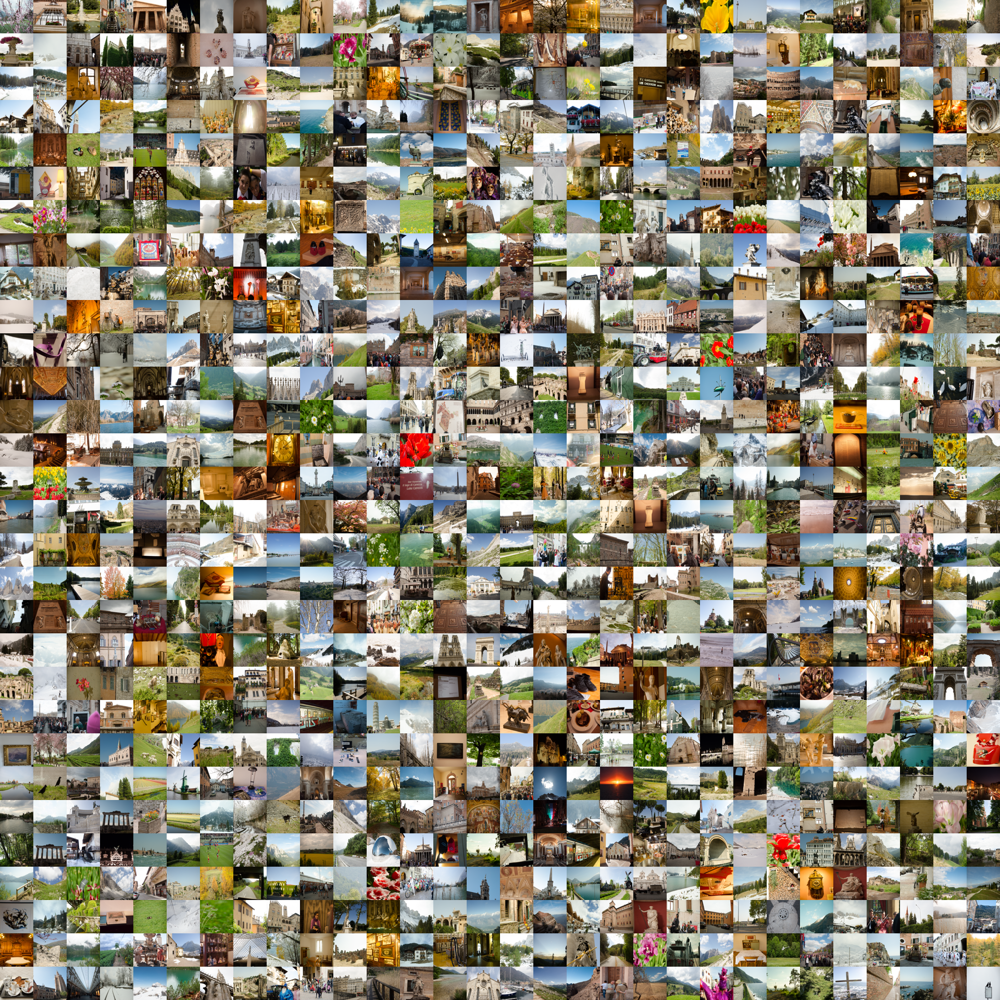

In [28]:
display(IPImage(real_low_collage_output))
display(IPImage(synthetic_low_collage_output))
display(IPImage(os.path.join(output_dir, "Collage_Real_Normal.png")))
display(IPImage(os.path.join(output_dir, "Collage_Synthetic_Normal.png")))

Observations so far:
- All Real dataset images 600x400
- Real dataset contains 2-4 "near-duplicates" of each image, explained [here](https://paperswithcode.com/dataset/lolv2)
- Image subjects align with dataset description

- All Synthetic dataset images 384x384
- Synthetic dataset focuses on foliage and architechture

# Histograms of pixel intensities (illuminance)

In [ ]:
def plot_pixel_intensity_histogram(directory, title):
    intensities = []
    for file in tqdm(get_image_files(directory), desc=f"Processing {title}"):
        with Image.open(os.path.join(directory, file)) as img:
            intensities.extend(list(img.convert("L").getdata())) 

    start_time = time.time()
    plt.figure(figsize=(7, 5))
    plt.hist(intensities, bins=256, range=(0, 256), color='#004282', alpha=1)
    plt.title(title)
    plt.xlabel("Pixel Intensity")
    plt.ylabel("Frequency")
    plt.savefig(os.path.join(output_dir,f"intensity_hist_{title}.png"))
    plt.close()
    end_time = time.time()
    print(f"Plotting time for {title}: {end_time - start_time:.2f} seconds")

#plot_pixel_intensity_histogram(synthetic_train_low_dir, "Synthetic_Low_Light")
#plot_pixel_intensity_histogram(synthetic_train_normal_dir, "Synthetic_Normal_Light")
#plot_pixel_intensity_histogram(real_train_low_dir, "Real_Low_Light")
#plot_pixel_intensity_histogram(real_train_normal_dir, "Real_Normal_Light")

#plot_pixel_intensity_histogram(real_low_ssim_dir, "Real_Low_SSIM")
#plot_pixel_intensity_histogram(synthetic_low_ssim_dir, "Synthetic_Low_SSIM")

Processing Real_Normal_Light: 100%|██████████| 689/689 [00:11<00:00, 61.44it/s]


Plotting time for Real_Normal_Light: 503.74 seconds


Processing Real_Low_SSIM: 100%|██████████| 137/137 [00:02<00:00, 49.23it/s]


Plotting time for Real_Low_SSIM: 76.76 seconds


Processing Synthetic_Low_SSIM: 100%|██████████| 180/180 [00:02<00:00, 83.53it/s]


Plotting time for Synthetic_Low_SSIM: 47.74 seconds


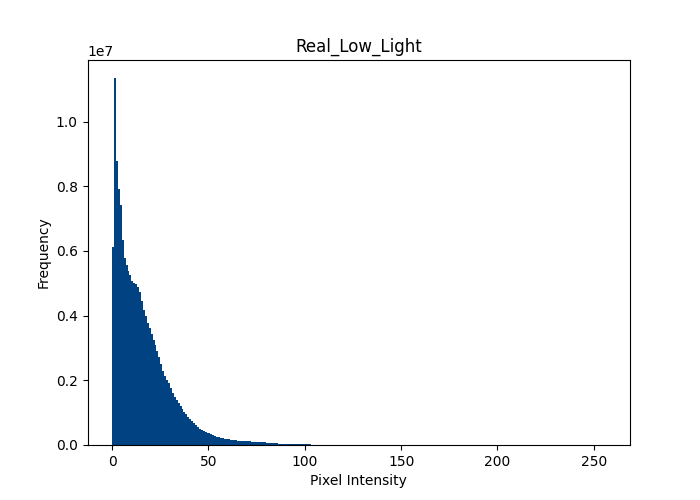

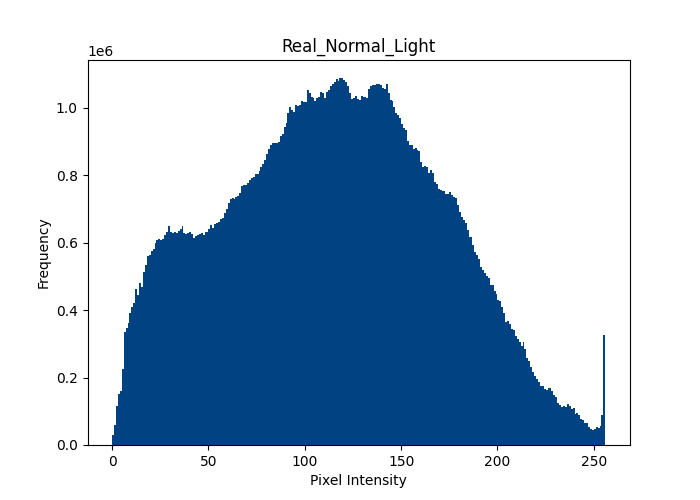

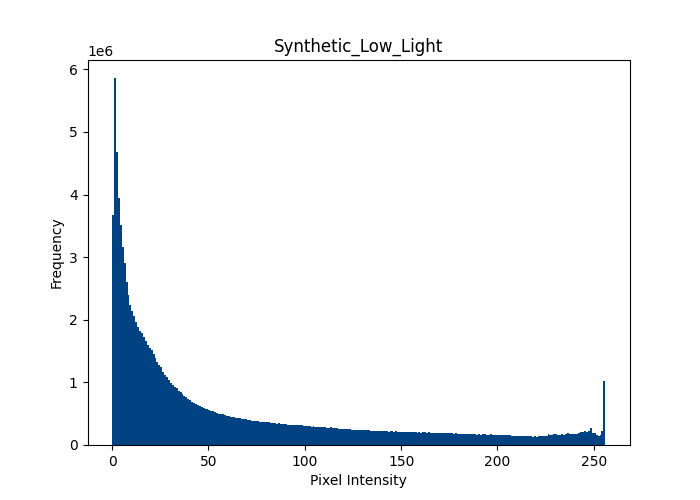

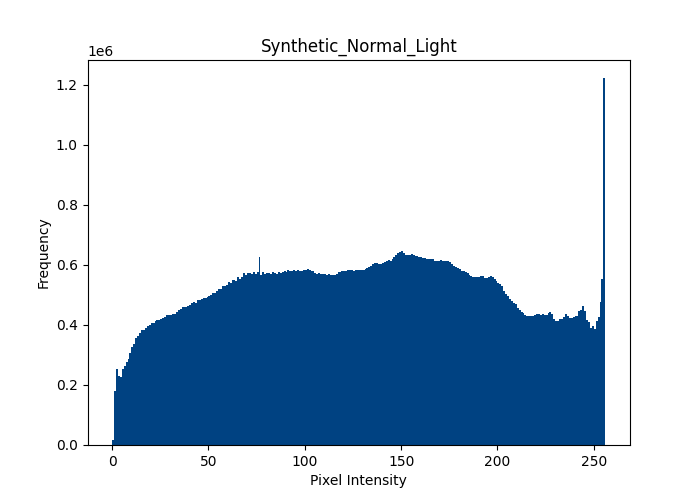

In [31]:
display(IPImage(os.path.join(output_dir,"intensity_hist_Real_Low_Light.png")))
display(IPImage(os.path.join(output_dir,"intensity_hist_Real_Normal_Light.png")))
display(IPImage(os.path.join(output_dir,"intensity_hist_Synthetic_Low_Light.png")))
display(IPImage(os.path.join(output_dir,"intensity_hist_Synthetic_Normal_Light.png")))

Observations:
- Clear skew towards low-intensity pixels in low light images. Hard to identify much about 0-illumination.
- Synthetic dataset has a more uniform distribution of pixel illuminance. Real dataset more normally distributed.

# Splitting by color channel

In [ ]:
def plot_rgb_histogram(directory, title):
    r, g, b = [], [], []
    for file in tqdm(get_image_files(directory), desc=f"Processing {title}"):
        with Image.open(os.path.join(directory, file)) as img:
            img = img.convert("RGB")
            r.extend(list(img.getdata(0)))
            g.extend(list(img.getdata(1)))
            b.extend(list(img.getdata(2)))

    start_time = time.time()
    plt.figure(figsize=(14, 10))

    # Combined line chart
    plt.subplot(2, 2, 1)
    r_hist, bins = np.histogram(r, bins=256, range=(0, 256))
    g_hist, _ = np.histogram(g, bins=256, range=(0, 256))
    b_hist, _ = np.histogram(b, bins=256, range=(0, 256))
    bin_centers = (bins[:-1] + bins[1:]) / 2
    plt.plot(bin_centers, r_hist, color='red', label='Red')
    plt.plot(bin_centers, g_hist, color='green', label='Green')
    plt.plot(bin_centers, b_hist, color='blue', label='Blue')
    plt.title(f"{title} - All Channels")
    plt.xlabel("Pixel Intensity")
    plt.ylabel("Frequency")
    plt.legend()


    # Red channel histogram
    plt.subplot(2, 2, 2)
    plt.hist(r, bins=256, range=(0, 256), color='red', alpha=0.7)
    plt.title(f"{title} - Red Channel")
    plt.xlabel("Pixel Intensity")
    plt.ylabel("Frequency")

    # Green channel histogram
    plt.subplot(2, 2, 3)
    plt.hist(g, bins=256, range=(0, 256), color='green', alpha=0.7)
    plt.title(f"{title} - Green Channel")
    plt.xlabel("Pixel Intensity")
    plt.ylabel("Frequency")

    # Blue channel histogram
    plt.subplot(2, 2, 4)
    plt.hist(b, bins=256, range=(0, 256), color='blue', alpha=0.7)
    plt.title(f"{title} - Blue Channel")
    plt.xlabel("Pixel Intensity")
    plt.ylabel("Frequency")

    plt.tight_layout()
    plt.savefig(os.path.join(output_dir, f"rgb_hists_{title}.png"))
    plt.close()
    end_time = time.time()
    print(f"Plotting time for {title}: {end_time - start_time:.2f} seconds")

#plot_rgb_histogram(synthetic_train_low_dir, "Synthetic_Low_Light")
#plot_rgb_histogram(synthetic_train_normal_dir, "Synthetic_Normal_Light")
#plot_rgb_histogram(real_train_low_dir, "Real_Low_Light")
#plot_rgb_histogram(real_train_normal_dir, "Real_Normal_Light")

#plot_rgb_histogram(real_low_ssim_dir, "Real_Low_SSIM")
#plot_rgb_histogram(synthetic_low_ssim_dir, "Synthetic_Low_SSIM")

Processing Synthetic_Low_Light: 100%|██████████| 900/900 [00:11<00:00, 78.08it/s] 


Plotting time for Synthetic_Low_Light: 564.39 seconds


Processing Synthetic_Normal_Light: 100%|██████████| 900/900 [00:11<00:00, 75.70it/s] 


Plotting time for Synthetic_Normal_Light: 590.52 seconds


Processing Real_Low_Light: 100%|██████████| 689/689 [00:15<00:00, 44.20it/s]


Plotting time for Real_Low_Light: 887.10 seconds


Processing Real_Normal_Light: 100%|██████████| 689/689 [00:16<00:00, 41.71it/s]


Plotting time for Real_Normal_Light: 1089.27 seconds


Processing Real_Low_SSIM: 100%|██████████| 137/137 [00:03<00:00, 41.13it/s]


Plotting time for Real_Low_SSIM: 122.41 seconds


Processing Synthetic_Low_SSIM: 100%|██████████| 180/180 [00:02<00:00, 75.05it/s]


Plotting time for Synthetic_Low_SSIM: 92.36 seconds


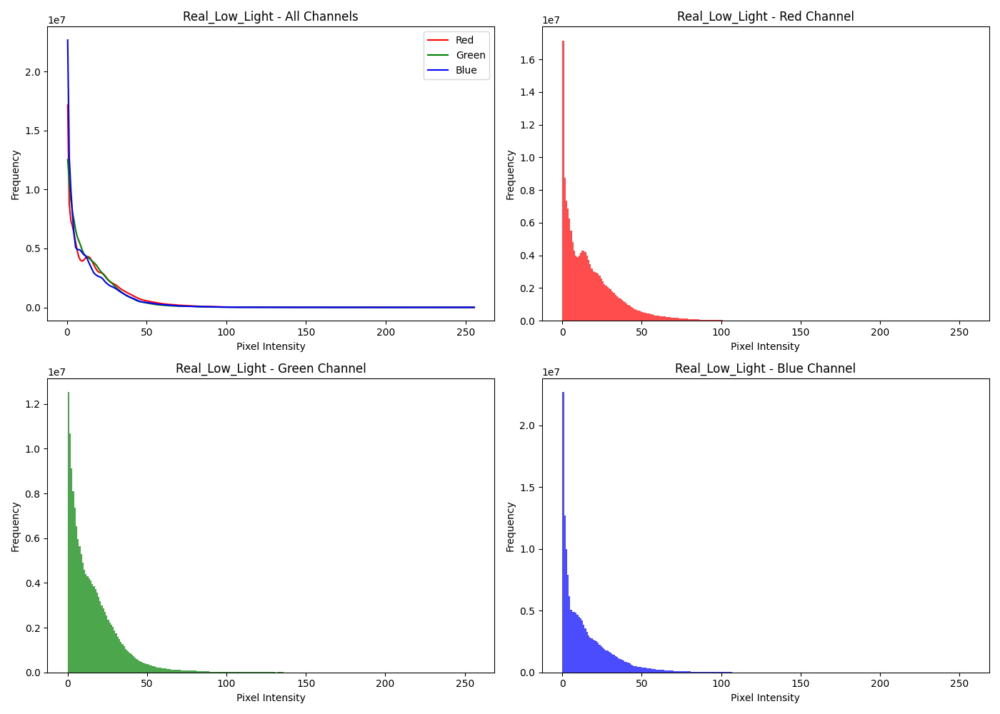

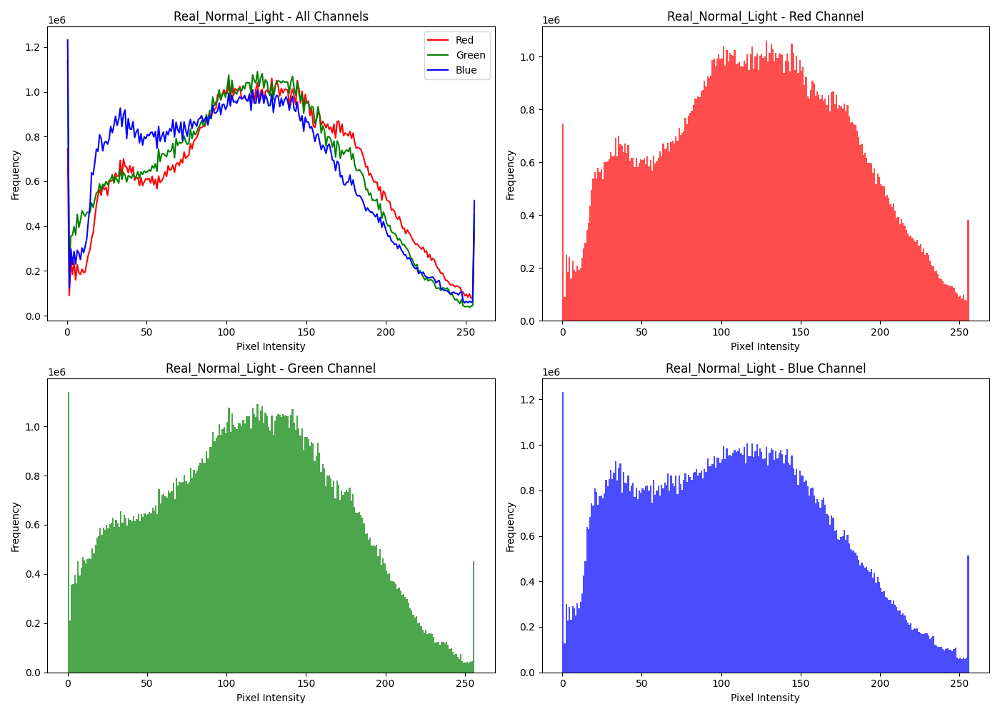

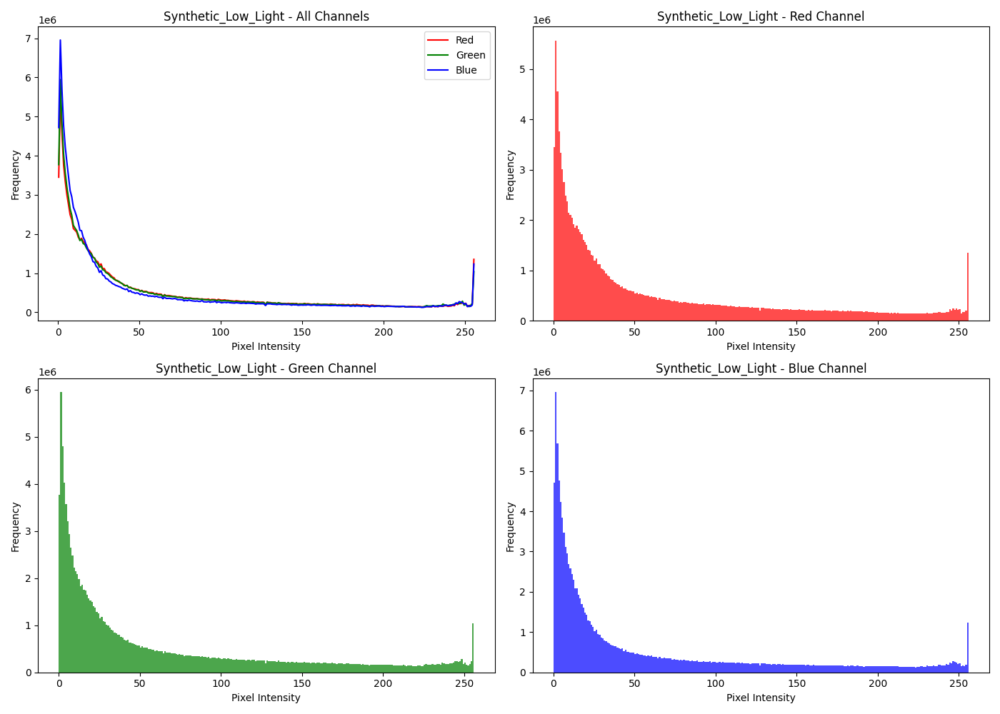

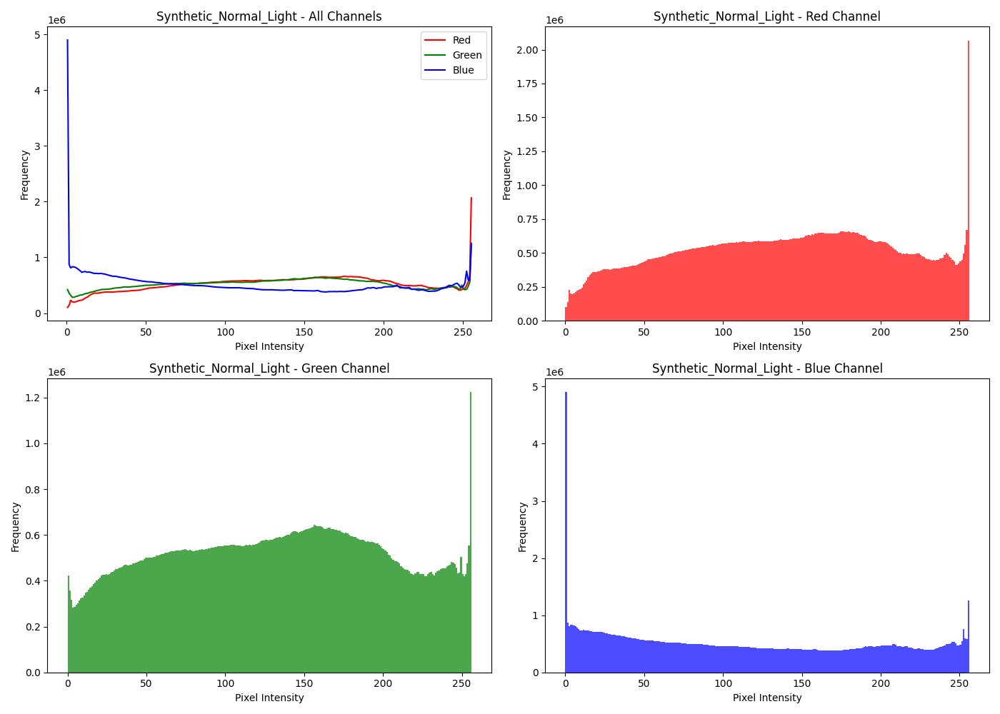

In [32]:
display(IPImage(os.path.join(output_dir,"rgb_hists_Real_Low_Light.png")))
display(IPImage(os.path.join(output_dir,"rgb_hists_Real_Normal_Light.png")))
display(IPImage(os.path.join(output_dir,"rgb_hists_Synthetic_Low_Light.png")))
display(IPImage(os.path.join(output_dir,"rgb_hists_Synthetic_Normal_Light.png")))

- In low-light images, all color channels are relatively equal
- In normal-light images, the blue channel has slightly more low-illumination pixels relative to the red and green channels. 
    - The inverse is true at higher illumination

# Examining only pixels at [0, 0, 0]

In [ ]:
def calculate_zero_intensity_proportion(directory):
    total_pixels = 0
    zero_intensity_pixels = 0
    
    for file in tqdm(get_image_files(directory), desc=f"Processing {directory}"):
        with Image.open(os.path.join(directory, file)) as img:
            img = img.convert("RGB")
            pixels = np.array(img)
            total_pixels += pixels.shape[0] * pixels.shape[1]
            zero_intensity_pixels += np.sum(np.all(pixels == [0, 0, 0], axis=-1))
    
    return zero_intensity_pixels / total_pixels if total_pixels > 0 else 0

datasets = {
    "Real_Low_Light": real_train_low_dir,
    #"Real_Low_SSIM": real_low_ssim_dir,
    "Real_Normal_Light": real_train_normal_dir,

    "Synthetic_Low_Light": synthetic_train_low_dir,
    #"Synthetic_Low_SSIM": synthetic_low_ssim_dir,
    "Synthetic_Normal_Light": synthetic_train_normal_dir
}

# Calculate proportions
proportions = {name: calculate_zero_intensity_proportion(directory) for name, directory in datasets.items()}

# Plot the proportions
plt.figure(figsize=(10, 6))
plt.bar(proportions.keys(), proportions.values(), color='black')
plt.title("Proportion of 0-Intensity Pixels in Each Dataset")
plt.xlabel("Dataset")
plt.ylabel("Proportion of 0-Intensity Pixels")
plt.xticks(rotation=45, ha="right")
plt.tight_layout()

# Save the plot
zero_intensity_plot_path = os.path.join(output_dir, "zero_intensity_proportions.png")
plt.savefig(zero_intensity_plot_path)
plt.close()

print(f"Zero-intensity pixel proportions plot saved to {zero_intensity_plot_path}")

Processing .\LOL-v2\Synthetic/Train/Normal: 100%|██████████| 900/900 [00:04<00:00, 194.06it/s]


Zero-intensity pixel proportions plot saved to .\EDAFigs\zero_intensity_proportions.png


In [ ]:
def count_images_with_zero_intensity(directory):
    count = 0
    total_images = 0

    for file in tqdm(get_image_files(directory), desc=f"Processing {directory}"):
        file_path = os.path.join(directory, file)
        with Image.open(file_path) as img:
            img = img.convert("RGB")
            pixels = np.array(img)

            # Check if there are no 0-intensity pixels
            if np.any(np.all(pixels == [0, 0, 0], axis=-1)):
                count += 1
            total_images += 1

    return count, total_images


def plot_images_with_no_zero_intensity(datasets):
    dataset_names = []
    zero_intensity_counts = []
    total_image_counts = []

    for name, directory in datasets.items():
        count, total = count_images_with_zero_intensity(directory)
        dataset_names.append(name)
        zero_intensity_counts.append(count)
        total_image_counts.append(total)

    plt.figure(figsize=(10, 6))
    plt.bar(dataset_names, total_image_counts, color='#004282', alpha=1, label="Total Images")
    plt.bar(dataset_names, zero_intensity_counts, color="black", alpha=1, label="Has 0-Intensity Pixels")
    plt.title("Number of Images containing 0-Intensity Pixels")
    plt.xlabel("Dataset")
    plt.ylabel("Number of Images")
    plt.xticks(rotation=45, ha="right")
    plt.legend()
    plt.tight_layout()

    output_path = os.path.join(output_dir, "images_with_zero_intensity.png")
    plt.savefig(output_path)
    plt.close()
    print(f"Plot saved to {output_path}")

datasets = {
    "Real_Low_Light": real_train_low_dir,
    "Real_Normal_Light": real_train_normal_dir,
    "Synthetic_Low_Light": synthetic_train_low_dir,
    "Synthetic_Normal_Light": synthetic_train_normal_dir,
}

plot_images_with_no_zero_intensity(datasets)

Processing .\LOL-v2\Synthetic/Train/Normal: 100%|██████████| 900/900 [00:07<00:00, 119.08it/s]


Plot saved to .\EDAFigs\images_with_zero_intensity.png


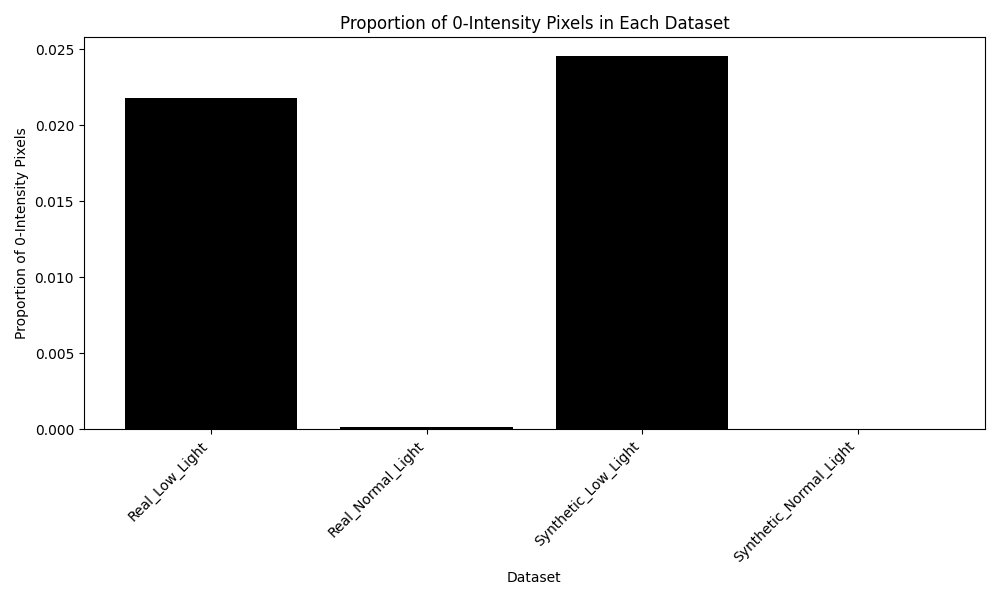

In [33]:
display(IPImage(os.path.join(output_dir,"zero_intensity_proportions.png")))

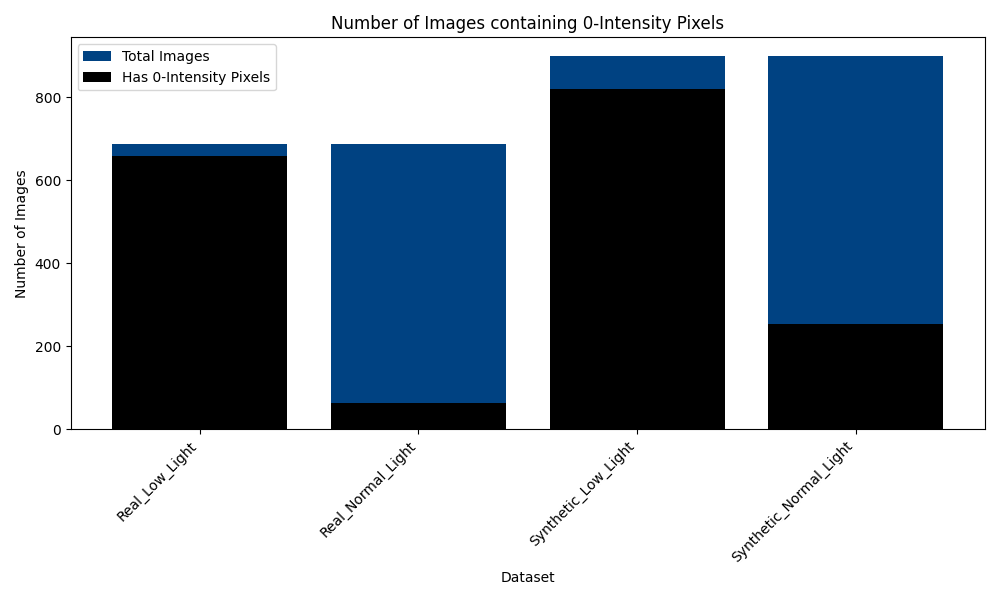

In [34]:
display(IPImage(os.path.join(output_dir,"images_with_zero_intensity.png")))

- Barely any 0-intensity pixels in the normal light images
- Most low light images contain 0 intensity pixels. 
- It isn't rare to get a normal-light image with 0 intensity pixels. However, the so those that do have barely any and are unlikely to take up a significant portion of the image. 

# Examining Retinexformer (No VAE) performance, based on illumination conditions

**The following plots use a dataset of the low-light images in the LOLv2 datasets with filenames that have been altered.** 

The filenames contain the the SSIM performance of the retinexformer model on those images.

In [ ]:
from scipy.stats import spearmanr

# LOL-v2\SSIM_Ranked
# LOL-v2\SSIM_Ranked\Real
# LOL-v2\SSIM_Ranked\Synthetic
ranked_dir = os.path.join(base_dir, "SSIM_Ranked")
real_ranked_dir = os.path.join(ranked_dir, "Real")
synthetic_ranked_dir = os.path.join(ranked_dir, "Synthetic")

def plot_ssim_vs_zero_intensity(directory, title):
    ssim_values = []
    zero_intensity_proportions = []

    # Process each image in the directory
    for file in tqdm(get_image_files(directory), desc=f"Processing {title}"):
        file_path = os.path.join(directory, file)
        with Image.open(file_path) as img:
            img = img.convert("RGB")
            pixels = np.array(img)

            # Calculate proportion of 0-intensity pixels
            total_pixels = pixels.shape[0] * pixels.shape[1]
            zero_intensity_pixels = np.sum(np.all(pixels == [0, 0, 0], axis=-1))
            zero_intensity_proportion = zero_intensity_pixels / total_pixels if total_pixels > 0 else 0
            zero_intensity_proportions.append(zero_intensity_proportion)

            # Extract SSIM from the filename
            try:
                ssim = float(file.split("_ssim_")[-1][:-4])
                ssim_values.append(ssim)
            except ValueError:
                print(f"Could not extract SSIM from filename: {file}")
                continue

    sorted_indices = np.argsort(ssim_values)
    ssim_values = np.array(ssim_values)[sorted_indices]
    zero_intensity_proportions = np.array(zero_intensity_proportions)[sorted_indices]

    # Correlation calculation
    spearman_corr, p_value = spearmanr(ssim_values, zero_intensity_proportions)
    print(f"Spearman's rank correlation coefficient for {title}: {spearman_corr:.2f}")
    print(f"P-value: {p_value:.2e}")


    plt.figure(figsize=(7, 7))
    plt.figure(figsize=(7, 7))
    plt.xscale("log")
    plt.scatter(zero_intensity_proportions, ssim_values, color="#004282", alpha=0.6)
    plt.title(f"{title}: Proportion of 0-Intensity Pixels vs. SSIM in the Low-Light Image (Log Scale)", wrap="center")
    plt.xlabel("Proportion of 0-Intensity Pixels (Log Scale)")
    plt.ylabel("SSIM")
    plt.grid(True)
    plt.legend()

    # Correlation Labels
    plt.text(
        0.05, 0.05,
        f"Spearman's ρ: {spearman_corr:.2f}\nP-value: {p_value:.2e}",
        transform=plt.gca().transAxes, 
        fontsize=10,
        bbox=dict(facecolor="white", alpha=0.8, edgecolor="gray")
    )

    plt.tight_layout()

    output_path = os.path.join(output_dir, f"ssim_vs_zero_intensity_{title}.png")
    plt.savefig(output_path)
    plt.close()
    print(f"Plot saved to {output_path}")

plot_ssim_vs_zero_intensity(real_ranked_dir, "Real Dataset")
plot_ssim_vs_zero_intensity(synthetic_ranked_dir, "Synthetic Dataset")

Processing Real Dataset: 100%|██████████| 689/689 [00:05<00:00, 135.70it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Spearman's rank correlation coefficient for Real Dataset: -0.34
P-value: 3.73e-20
Plot saved to .\EDAFigs\ssim_vs_zero_intensity_Real Dataset.png


Processing Synthetic Dataset: 100%|██████████| 900/900 [00:14<00:00, 61.32it/s] 
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Spearman's rank correlation coefficient for Synthetic Dataset: -0.42
P-value: 2.71e-40
Plot saved to .\EDAFigs\ssim_vs_zero_intensity_Synthetic Dataset.png


In [ ]:
def plot_ssim_vs_average_illuminance(directory, title):
    ssim_values = []
    average_illuminance_values = []

    # Process each image in the directory
    for file in tqdm(get_image_files(directory), desc=f"Processing {title}"):
        file_path = os.path.join(directory, file)
        with Image.open(file_path) as img:
            img = img.convert("L") 
            pixels = np.array(img)
            
            # Calculate average illuminance
            average_illuminance = np.mean(pixels)
            average_illuminance_values.append(average_illuminance)

            # Extract SSIM from the filename
            try:
                ssim = float(file.split("_ssim_")[-1][:-4])
                ssim_values.append(ssim)
            except ValueError:
                print(f"Could not extract SSIM from filename: {file}")
                continue

    sorted_indices = np.argsort(ssim_values)
    ssim_values = np.array(ssim_values)[sorted_indices]
    average_illuminance_values = np.array(average_illuminance_values)[sorted_indices]

    # Calculate correlation
    spearman_corr, p_value = spearmanr(ssim_values, average_illuminance_values)

    print(f"Spearman's rank correlation coefficient for {title}: {spearman_corr:.2f}")
    print(f"P-value: {p_value:.2e}")

    plt.figure(figsize=(7, 7))
    plt.scatter(average_illuminance_values, ssim_values, color="#004282", alpha=0.6)
    plt.title(f"{title}: Average Illuminance vs. SSIM", wrap=True)
    plt.xlabel("Average Illuminance")
    plt.ylabel("SSIM")
    plt.grid(True)

    # Add correlation labels
    plt.text(
        0.05, 0.05,
        f"Spearman's ρ: {spearman_corr:.2f}\nP-value: {p_value:.2e}",
        transform=plt.gca().transAxes,
        fontsize=10,
        bbox=dict(facecolor="white", alpha=0.8, edgecolor="gray")
    )

    plt.tight_layout()

    output_path = os.path.join(output_dir, f"ssim_vs_average_illuminance_{title}.png")
    plt.savefig(output_path)
    plt.close()
    print(f"Plot saved to {output_path}")

plot_ssim_vs_average_illuminance(real_ranked_dir, "Real Dataset")
plot_ssim_vs_average_illuminance(synthetic_ranked_dir, "Synthetic Dataset")

Processing Real Dataset: 100%|██████████| 689/689 [00:09<00:00, 75.67it/s]


Spearman's rank correlation coefficient for Real Dataset: 0.19
P-value: 9.89e-07
Plot saved to .\EDAFigs\ssim_vs_average_illuminance_Real Dataset.png


Processing Synthetic Dataset: 100%|██████████| 900/900 [00:09<00:00, 93.15it/s]


Spearman's rank correlation coefficient for Synthetic Dataset: -0.02
P-value: 5.92e-01
Plot saved to .\EDAFigs\ssim_vs_average_illuminance_Synthetic Dataset.png


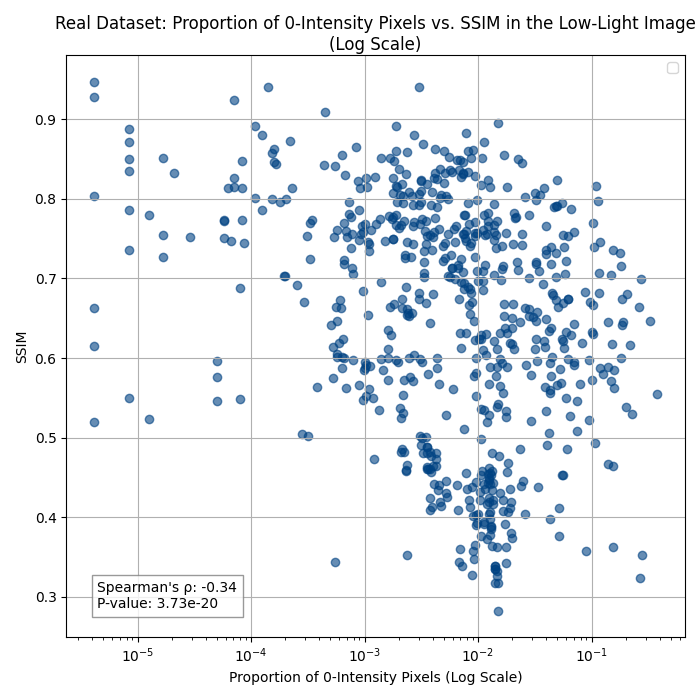

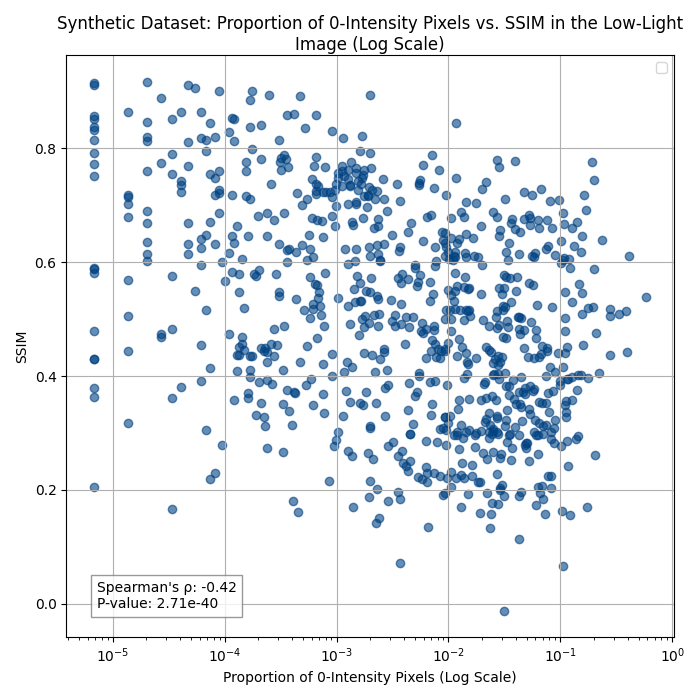

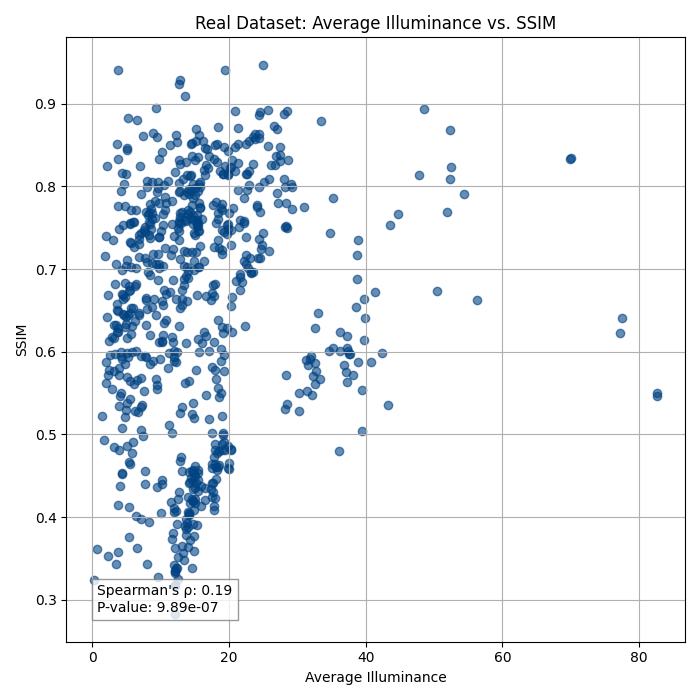

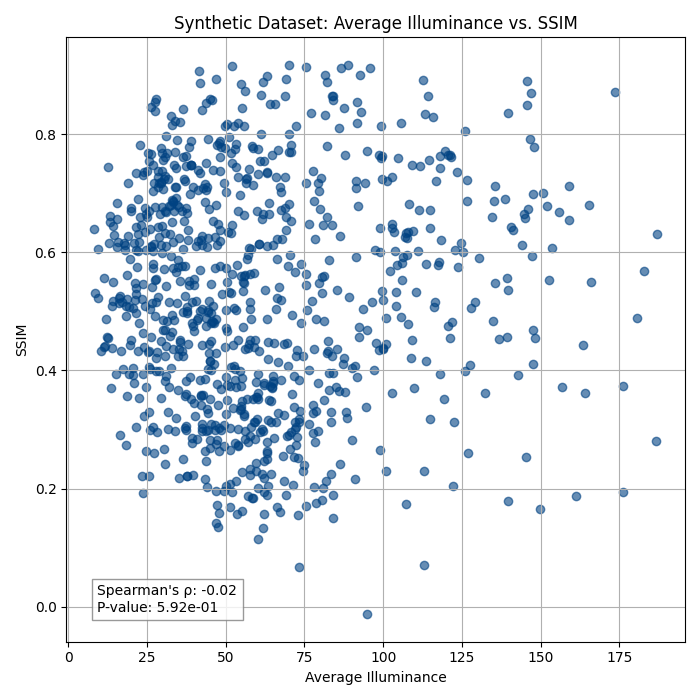

In [35]:
display(IPImage(os.path.join(output_dir,"ssim_vs_zero_intensity_Real Dataset.png")))
display(IPImage(os.path.join(output_dir,"ssim_vs_zero_intensity_Synthetic Dataset.png")))
display(IPImage(os.path.join(output_dir,"ssim_vs_average_illuminance_Real Dataset.png")))
display(IPImage(os.path.join(output_dir,"ssim_vs_average_illuminance_Synthetic Dataset.png")))

## SSIM vs Proportion of 0 Intensity Pixels in an image

| Dataset    | Spearman's ρ | P-value    |
|------------|-----------------------------------------|------------|
| Real       | -0.34                                  | 3.73e-20   |
| Synthetic  | -0.42                                  | 2.71e-40   |

## SSIM vs Average Illuminance of an image

| Dataset    | Spearman's ρ | P-value    |
|------------|-----------------------------------------|------------|
| Real       | 0.19                                   | 9.89e-07   |
| Synthetic  | -0.02                                  | 5.92e-01   |

Spearman's Rank Correlation Coefficient is used because it is scale invariant, giving comparable values for both metrics.

There is a moderate negative correlation between SSIM and the proportion of 0-intensity pixels, with strong statistical significance. This suggests that as the proportion of 0-intensity pixels increases, the performance of the Retinexformer (without VAE) model decreases.

Comparatively, there is weak positive or no correlation between SSIM and image illuminance, suggesting that generally dark images don't cause significant problems for the retinexformer model. This further shows that extreme dark pixels are a problem, rather than just darker images in general.